<a href="https://colab.research.google.com/github/Mshitritt/Deep_Learning_Course/blob/main/vegetable_clf.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Opening & problem statement

Given an input image of a vegetable, the goal is to develop a deep learning model that can automatically classify the image into one of the predefined vegetable categories with high accuracy.
The model should be rebust to variations in lighting, background, orientation, and noise while ensuring computational efficiency for real-world deployment.

Challenges & Considerations
1. High Intra-Class Variability: Vegetables of the same category may have
different shapes, textures, and colors.
2. Background Noise: Images may contain additional elements such as packaging, cutting boards, or other food items.


In [1]:
import tensorflow as tf
import matplotlib.pyplot as plt

import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

from keras.models import Sequential
from keras.preprocessing import image

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16, InceptionV3
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

import kagglehub
import os
import warnings
import numpy as np
warnings.filterwarnings('ignore')

In [2]:
# Connection to Kaggle dataset
path = kagglehub.dataset_download("misrakahmed/vegetable-image-dataset")

print("Path to dataset files:", path)
train_file = path + '/Vegetable Images/train'
test_file = path + '/Vegetable Images/test'
validation_file = path + '/Vegetable Images/validation'
image_classes=os.listdir(path + '/Vegetable Images/train')

100%|██████████| 534M/534M [00:03<00:00, 147MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/misrakahmed/vegetable-image-dataset/versions/1


# <font color=#4EC9B0>**Phase 1 - Data Exploration**</font>


In [3]:
# Get the image classes
image_classes=os.listdir(path + '/Vegetable Images/train')
image_classes

['Pumpkin',
 'Broccoli',
 'Brinjal',
 'Capsicum',
 'Radish',
 'Cucumber',
 'Papaya',
 'Bitter_Gourd',
 'Bean',
 'Carrot',
 'Bottle_Gourd',
 'Cabbage',
 'Potato',
 'Cauliflower',
 'Tomato']

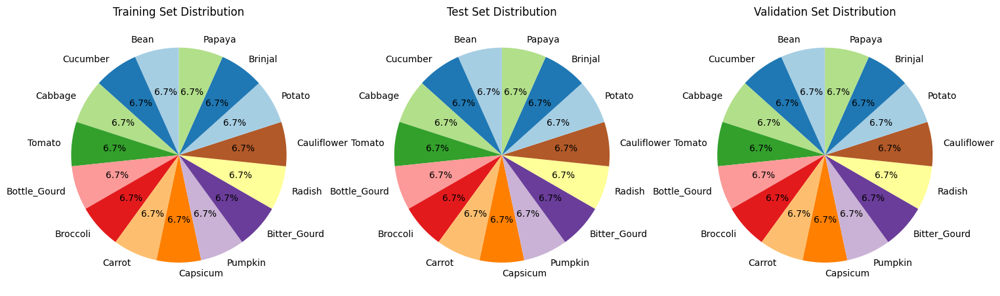

In [ ]:
image_classes = os.listdir(train_file)

train_counts = {cls: len(os.listdir(os.path.join(train_file, cls))) for cls in image_classes}
test_counts = {cls: len(os.listdir(os.path.join(test_file, cls))) for cls in image_classes}
validation_counts = {cls: len(os.listdir(os.path.join(validation_file, cls))) for cls in image_classes}

sorted_classes = sorted(train_counts, key=train_counts.get, reverse=True)

sorted_train_counts = [train_counts[cls] for cls in sorted_classes]
sorted_test_counts = [test_counts[cls] for cls in sorted_classes]
sorted_validation_counts = [validation_counts[cls] for cls in sorted_classes]

fig, axes = plt.subplots(1, 3, figsize=(18, 6))

axes[0].pie(sorted_train_counts, labels=sorted_classes, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
axes[0].set_title("Training Set Distribution")

axes[1].pie(sorted_test_counts, labels=sorted_classes, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
axes[1].set_title("Test Set Distribution")

axes[2].pie(sorted_validation_counts, labels=sorted_classes, autopct='%1.1f%%', startangle=90, colors=plt.cm.Paired.colors)
axes[2].set_title("Validation Set Distribution")

plt.show()

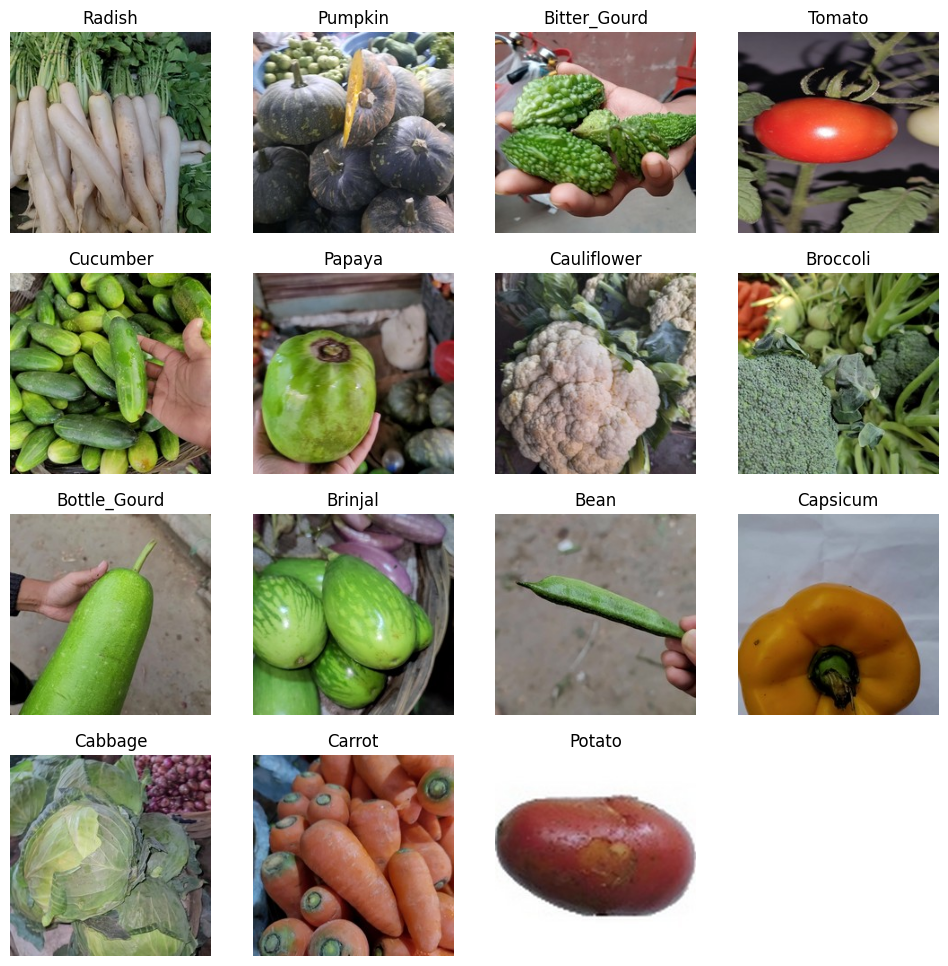

In [ ]:
# Plot image example of each class
plt.figure(figsize=(12,12))
for i , category in enumerate(image_classes):

    image_path=train_file + '/' + category
    image_in_folder=os.listdir(image_path)

    first_image=image_in_folder[0]
    first_image_path=image_path + '/'+first_image

    img=tf.keras.utils.load_img(first_image_path)
    img_array=tf.keras.utils.img_to_array(img)/255

    plt.subplot(4,4,i+1)
    plt.imshow(img_array)
    plt.title(category)
    plt.axis('off')

plt.show()

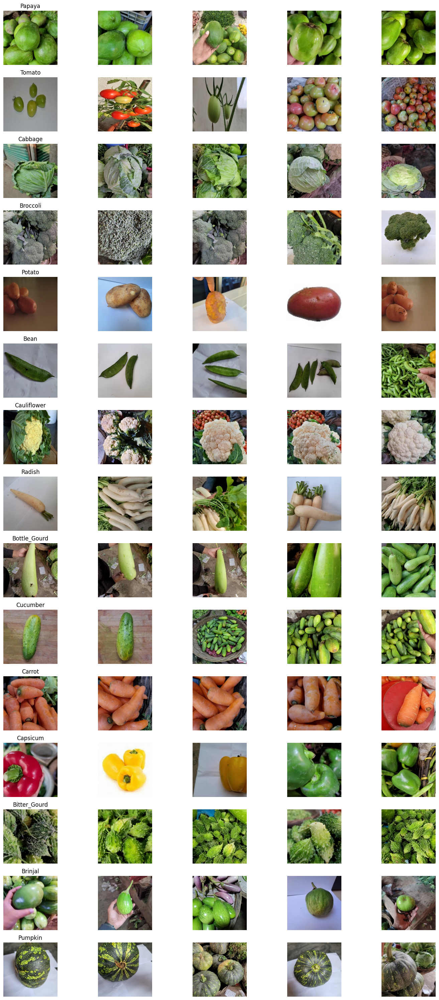

In [ ]:
# Define number of classes and images per class
num_classes = 15  # Adjust based on your dataset
images_per_class = 5

# Create figure with 15 rows (one per class), 5 columns (one per image)
fig, axes = plt.subplots(num_classes, images_per_class, figsize=(15, num_classes * 2))

# Loop through each class
for i, category in enumerate(image_classes[:num_classes]):
    image_path = os.path.join(train_file, category)
    image_files = os.listdir(image_path)[:images_per_class]  # Get first 5 images

    # Loop through first 5 images of the class
    for j, img_name in enumerate(image_files):
        img_path = os.path.join(image_path, img_name)

        # Load and process image
        img = tf.keras.utils.load_img(img_path)  # Load image
        img_array = tf.keras.utils.img_to_array(img) / 255.0  # Normalize

        # Plot image
        axes[i, j].imshow(img_array)
        if j == 0:
            axes[i, j].set_title(category, fontsize=12)  # Label first image in row
        axes[i, j].axis("off")

# Adjust layout and show plot
plt.tight_layout()
plt.show()

In [ ]:
# Print image properties
sample_class = image_classes[0]
sample_image_path = os.path.join(train_file, sample_class, os.listdir(os.path.join(train_file, sample_class))[0])

img = tf.keras.utils.load_img(sample_image_path)
img_array = tf.keras.utils.img_to_array(img)

image_shape = img_array.shape
min_value = np.min(img_array)
max_value = np.max(img_array)

print(f"Sample Image Path: {sample_image_path}")
print(f"Image Shape (Height, Width, Channels): {image_shape}")
print(f"Min Pixel Value: {min_value}")
print(f"Max Pixel Value: {max_value}")

Sample Image Path: /root/.cache/kagglehub/datasets/misrakahmed/vegetable-image-dataset/versions/1/Vegetable Images/train/Bean/0735.jpg
Image Shape (Height, Width, Channels): (224, 224, 3)
Min Pixel Value: 0.0
Max Pixel Value: 233.0


# <font color=#4EC9B0>**Phase 2 - Data Preparation**</font>


In [4]:
# Load images

data_generator=ImageDataGenerator(rescale=1/255.0) # Rescale the image values to be in range [0, 1]

train_data=data_generator.flow_from_directory(train_file,
                                             target_size=(224,224),
                                              batch_size=16,
                                              class_mode='categorical'
                                             )
test_data=data_generator.flow_from_directory(test_file,
                                             target_size=(224,224),
                                             batch_size=10,
                                             class_mode='categorical',
                                             shuffle=False
                                             )
val_data = data_generator.flow_from_directory(validation_file,
                                              target_size = (224,224),
                                               batch_size = 32,
                                               class_mode = 'categorical')

Found 15000 images belonging to 15 classes.
Found 3000 images belonging to 15 classes.
Found 3000 images belonging to 15 classes.


In [5]:
# Get a batch of images and labels from the train_data generator
images, labels = next(train_data)

sample_image = images[0]

image_shape = sample_image.shape
min_value = np.min(sample_image)
max_value = np.max(sample_image)

print(f"Image Shape (Height, Width, Channels): {image_shape}")
print(f"Min Pixel Value: {min_value}")
print(f"Max Pixel Value: {max_value}")

Image Shape (Height, Width, Channels): (224, 224, 3)
Min Pixel Value: 0.0
Max Pixel Value: 0.9960784912109375


# <font color=#4EC9B0>**Phase 3 - CNN Model Selection**</font>


## <font color=#00FF00>**3.1 - Custom CNN Architecture - Based on LeNet-5 Architecture**</font>
<font color=#00FF00>This code defines a Convolutional Neural Network (CNN) model using Keras' Sequential API for vegetable classification. The architecture is inspired by LeNet-5, with convolutional layers for feature extraction followed by fully connected layers for classification.

</font>



<font color=#00FF00># Model Architecture</font>


In [17]:
customeModel = Sequential()


# Layer 1: First Convolutional Layer (5x5 kernel, 6 filters)
customeModel.add(Conv2D(filters=6, kernel_size=(5, 5), activation='relu', input_shape=(224, 224, 3)))
customeModel.add(AveragePooling2D(pool_size=(2, 2)))  # Average Pooling

# Layer 2: Second Convolutional Layer (5x5 kernel, 6 filters)
customeModel.add(Conv2D(filters=6, kernel_size=(5, 5), activation='relu'))
customeModel.add(AveragePooling2D(pool_size=(2, 2)))  # Average Pooling

# Flatten before Fully Connected Layers
customeModel.add(Flatten())

# Fully Connected Layer 2: 84 Neurons
customeModel.add(Dense(84, activation='relu'))

# Output Layer: Softmax for Classification
customeModel.add(Dense(15, activation='softmax'))


In [18]:
customeModel.compile(optimizer='adam',
             loss='categorical_crossentropy',
             metrics=['accuracy'])

<font color=#00FF00># Model Training</font>

In [ ]:
customeModel_history=customeModel.fit(train_data,
                                      validation_data=val_data,
                                      epochs=5)

Epoch 1/5
938/938 ━━━━━━━━━━━━━━━━━━━━ 37s 37ms/step - accuracy: 0.3822 - loss: 1.8923 - val_accuracy: 0.7037 - val_loss: 0.9532
Epoch 2/5
938/938 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - accuracy: 0.7568 - loss: 0.7670 - val_accuracy: 0.7590 - val_loss: 0.7803
Epoch 3/5
938/938 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - accuracy: 0.8559 - loss: 0.4586 - val_accuracy: 0.7857 - val_loss: 0.7186
Epoch 4/5
938/938 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - accuracy: 0.9064 - loss: 0.2931 - val_accuracy: 0.7733 - val_loss: 0.8608
Epoch 5/5
938/938 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - accuracy: 0.9368 - loss: 0.1988 - val_accuracy: 0.8027 - val_loss: 0.7800


In [ ]:
customeModel.save("veg_clf_custome_80_.h5")


<font color=#00FF00># Model Evaluation</font>

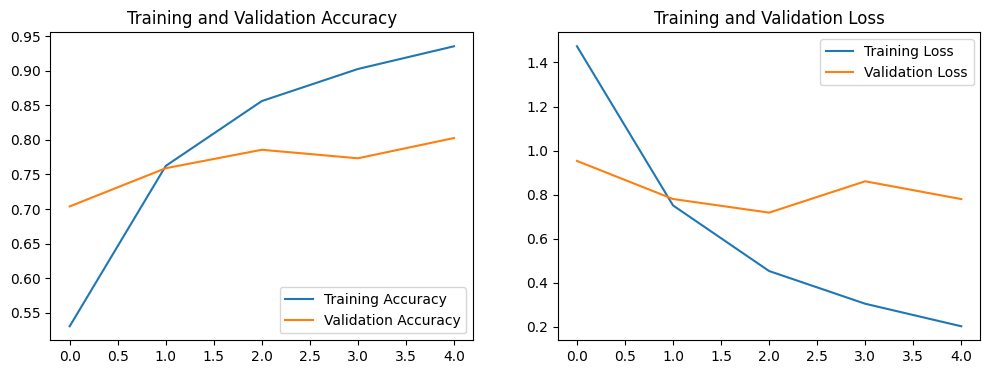

In [ ]:
# Ploting the accuracy score graph

# Extract history data
acc = customeModel_history.history['accuracy']
val_acc = customeModel_history.history['val_accuracy']
loss = customeModel_history.history['loss']
val_loss = customeModel_history.history['val_loss']
epochs_range = range(len(acc))

# Plot Accuracy
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

# Plot Loss
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')

plt.show()

In [ ]:
# Silent predict to avoid printing during the process
def silent_predict(model, images):
    return model(images, training=False)

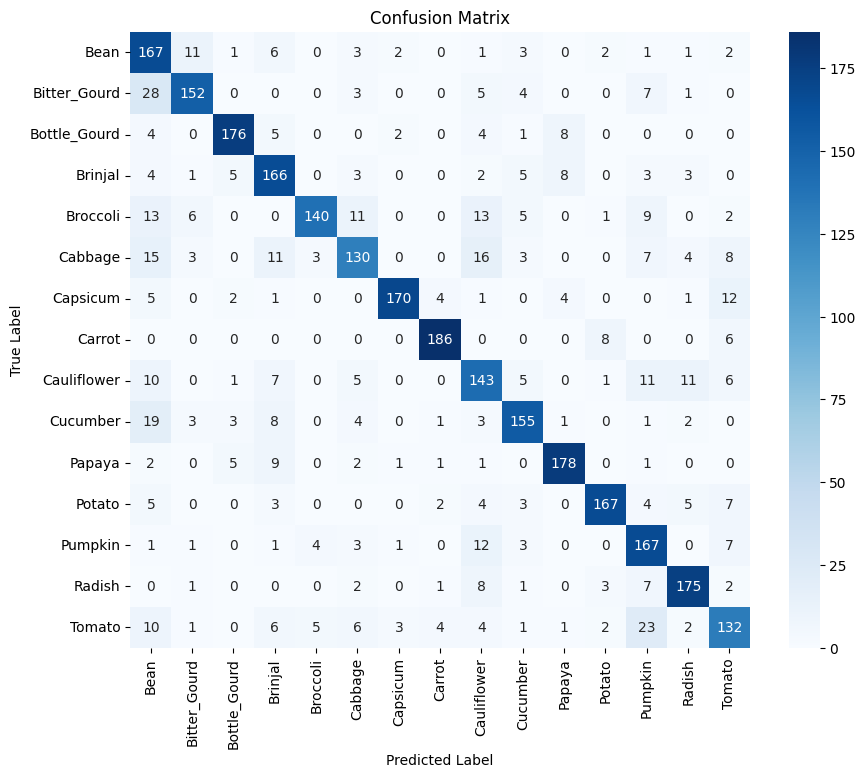

Classification Report:
               precision    recall  f1-score   support

        Bean       0.59      0.83      0.69       200
Bitter_Gourd       0.85      0.76      0.80       200
Bottle_Gourd       0.91      0.88      0.90       200
     Brinjal       0.74      0.83      0.78       200
    Broccoli       0.92      0.70      0.80       200
     Cabbage       0.76      0.65      0.70       200
    Capsicum       0.95      0.85      0.90       200
      Carrot       0.93      0.93      0.93       200
 Cauliflower       0.66      0.71      0.69       200
    Cucumber       0.82      0.78      0.80       200
      Papaya       0.89      0.89      0.89       200
      Potato       0.91      0.83      0.87       200
     Pumpkin       0.69      0.83      0.76       200
      Radish       0.85      0.88      0.86       200
      Tomato       0.72      0.66      0.69       200

    accuracy                           0.80      3000
   macro avg       0.81      0.80      0.80      3000
we

In [ ]:
# Ploting confusion matrix

y_true = []
y_pred = []

for images, labels in test_data:
    preds = silent_predict(customeModel, images)
    y_true.extend(np.argmax(labels, axis=1))
    y_pred.extend(np.argmax(preds, axis=1))

    if len(y_true) >= test_data.samples:
        break

cm = confusion_matrix(y_true, y_pred)

class_labels = list(test_data.class_indices.keys())

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_true, y_pred, target_names=class_labels))


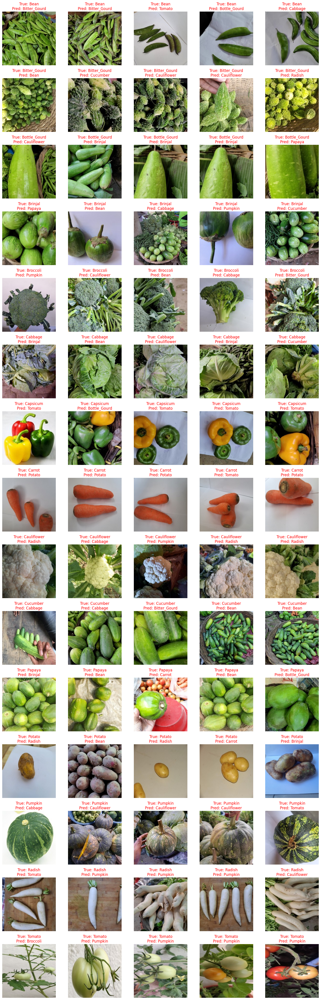

In [ ]:
y_true = []
y_pred = []
misclassified_images = {cls: [] for cls in test_data.class_indices.keys()}

for images, labels in test_data:
    preds = silent_predict(customeModel, images)
    true_classes = np.argmax(labels, axis=1)
    predicted_classes = np.argmax(preds, axis=1)

    for i in range(len(true_classes)):
        if true_classes[i] != predicted_classes[i]:
            class_name = list(test_data.class_indices.keys())[true_classes[i]]
            if len(misclassified_images[class_name]) < 5:
                misclassified_images[class_name].append((images[i], true_classes[i], predicted_classes[i]))

    if all(len(misclassified_images[cls]) >= 5 for cls in misclassified_images):
        break

fig, axes = plt.subplots(len(misclassified_images), 5, figsize=(15, 3 * len(misclassified_images)))

for i, (cls, images_list) in enumerate(misclassified_images.items()):
    for j, (img, true_class, pred_class) in enumerate(images_list):
        axes[i, j].imshow(img)
        true_label = list(test_data.class_indices.keys())[true_class]
        pred_label = list(test_data.class_indices.keys())[pred_class]
        axes[i, j].set_title(f"True: {true_label}\nPred: {pred_label}", color='red')
        axes[i, j].axis("off")

plt.tight_layout()
plt.show()


## <font color=#FFC107>**3.2 - VGG CNN Architecture - Transfer Learning**</font>
<font color=#FFC107>
VGG’s key advantages are its

*   Depth
*   Feature Extraction

</font>
<font color=#FFC107>
Although parameter-heavy, VGG benefits from better feature reusability and is highly effective in transfer learning.

This makes it well-suited for vegetable classification, where capturing fine details in texture and shape is more critical than computational efficiency.
</font>


## VGG Base line - without pre trained weights

In [7]:
# Load VGG16 without top layers (fully connected layers)
base_line_VGG = VGG16(weights=None, include_top=False, input_shape=(224, 224, 3))

# Freeze the convolutional base (prevent modifying pre-trained weights)
for layer in base_line_VGG.layers:
    layer.trainable = False

# Create a custom classifier
baseLine_model_VGG = Sequential([
    base_line_VGG,  # Pre-trained VGG16 model
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(15, activation='softmax')
])

baseLine_model_VGG.compile(optimizer=Adam(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# training process
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

base_history_VGG = baseLine_model_VGG.fit(
    train_data,
    validation_data=val_data,
    epochs=10,
    batch_size=32,
    callbacks=[early_stopping]
)

Epoch 1/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - accuracy: 0.0741 - loss: 2.7060 - val_accuracy: 0.0943 - val_loss: 2.6968
Epoch 2/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 21s 23ms/step - accuracy: 0.1080 - loss: 2.6930 - val_accuracy: 0.2400 - val_loss: 2.6800
Epoch 3/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 21s 22ms/step - accuracy: 0.1443 - loss: 2.6760 - val_accuracy: 0.2523 - val_loss: 2.6556
Epoch 4/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 21s 23ms/step - accuracy: 0.1622 - loss: 2.6488 - val_accuracy: 0.2563 - val_loss: 2.6231
Epoch 5/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 21s 22ms/step - accuracy: 0.1732 - loss: 2.6173 - val_accuracy: 0.2730 - val_loss: 2.5851
Epoch 6/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 21s 22ms/step - accuracy: 0.1779 - loss: 2.5871 - val_accuracy: 0.2977 - val_loss: 2.5451
Epoch 7/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 21s 23ms/step - accuracy: 0.1921 - loss: 2.5482 - val_accuracy: 0.2970 - val_loss: 2.5059
Epoch 8/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 21s 23ms/step - accuracy: 0.2099 - loss: 2.5086 - 

In [8]:
baseLine_model_VGG.save("veg_clf_baseLine_VGG_.h5")

# Evaluation

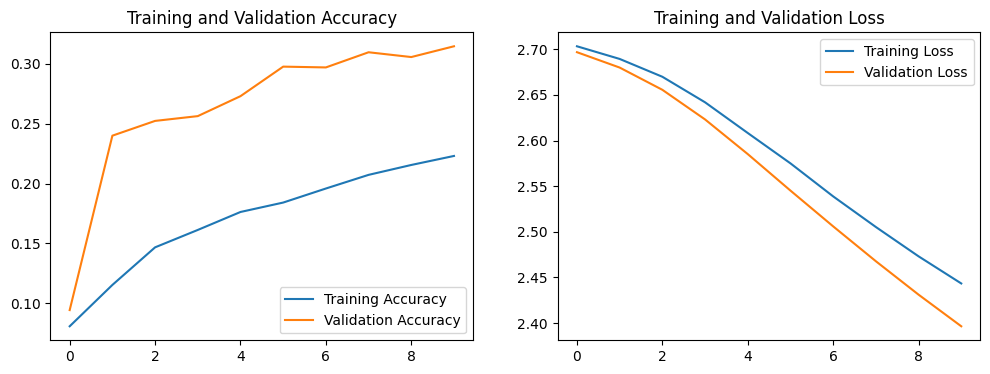

In [9]:
# Ploting the accuracy score graph

# Extract history data
acc = base_history_VGG.history['accuracy']
val_acc = base_history_VGG.history['val_accuracy']
loss = base_history_VGG.history['loss']
val_loss = base_history_VGG.history['val_loss']
epochs_range = range(len(acc))

# Plot Accuracy
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

# Plot Loss
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')

plt.show()

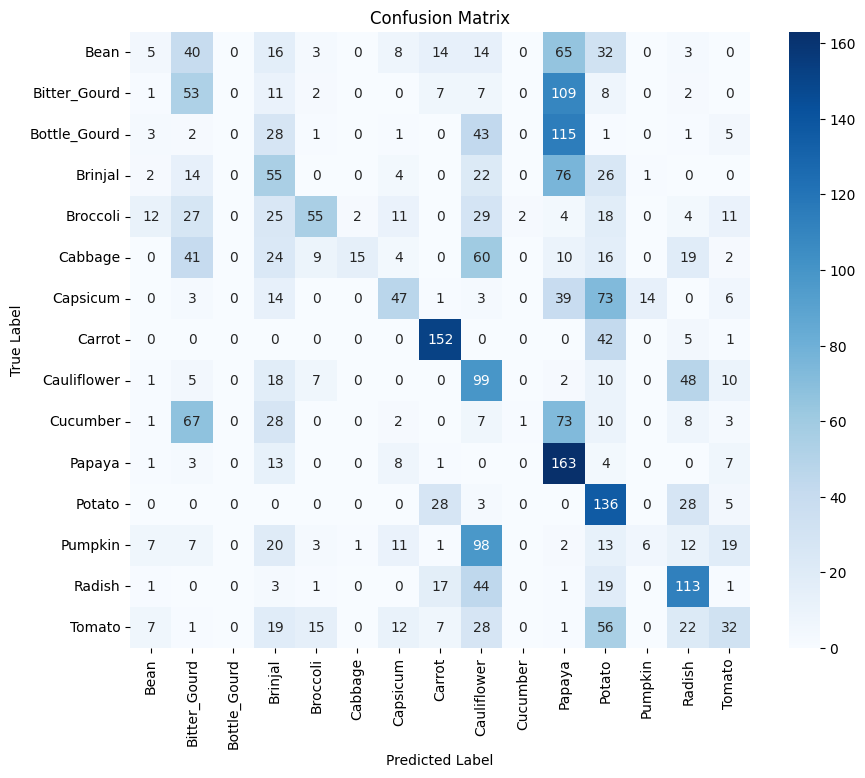

Classification Report:
               precision    recall  f1-score   support

        Bean       0.12      0.03      0.04       200
Bitter_Gourd       0.20      0.27      0.23       200
Bottle_Gourd       0.00      0.00      0.00       200
     Brinjal       0.20      0.28      0.23       200
    Broccoli       0.57      0.28      0.37       200
     Cabbage       0.83      0.07      0.14       200
    Capsicum       0.44      0.23      0.31       200
      Carrot       0.67      0.76      0.71       200
 Cauliflower       0.22      0.49      0.30       200
    Cucumber       0.33      0.01      0.01       200
      Papaya       0.25      0.81      0.38       200
      Potato       0.29      0.68      0.41       200
     Pumpkin       0.29      0.03      0.05       200
      Radish       0.43      0.56      0.49       200
      Tomato       0.31      0.16      0.21       200

    accuracy                           0.31      3000
   macro avg       0.34      0.31      0.26      3000
we

In [10]:
# Ploting confusion matrix

# Ensure all images are processed
steps = test_data.samples // test_data.batch_size

# Get predictions
y_pred_probs = baseLine_model_VGG.predict(test_data, steps=steps, verbose=0)  # Silent prediction
y_pred = np.argmax(y_pred_probs, axis=1)  # Convert probabilities to class indices


y_true = test_data.classes

cm = confusion_matrix(y_true, y_pred)

class_labels = list(test_data.class_indices.keys())

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

print("Classification Report:\n", classification_report(y_true, y_pred, target_names=class_labels))

--------------------------------------------------------------------------------------------------------------------

## VGG Architecture With IMAGENET weights


In [ ]:
# Load VGG16 without top layers (fully connected layers)
base_model_VGG = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the convolutional base (prevent modifying pre-trained weights)
for layer in base_model_VGG.layers:
    layer.trainable = False

# Create a custom classifier
model_VGG = Sequential([
    base_model_VGG,  # Pre-trained VGG16 model
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(15, activation='softmax')
])

model_VGG.compile(optimizer=Adam(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


<font color=#FFC107>Model Training</font>

In [ ]:
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

history_VGG = model_VGG.fit(
    train_data,
    validation_data=val_data,
    epochs=10,
    batch_size=32,
    callbacks=[early_stopping]
)

Epoch 1/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - accuracy: 0.6139 - loss: 1.3046 - val_accuracy: 0.9757 - val_loss: 0.1505
Epoch 2/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 24s 26ms/step - accuracy: 0.9334 - loss: 0.2723 - val_accuracy: 0.9877 - val_loss: 0.0729
Epoch 3/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 23s 25ms/step - accuracy: 0.9652 - loss: 0.1457 - val_accuracy: 0.9907 - val_loss: 0.0442
Epoch 4/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 24s 25ms/step - accuracy: 0.9770 - loss: 0.1020 - val_accuracy: 0.9923 - val_loss: 0.0348
Epoch 5/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 24s 26ms/step - accuracy: 0.9817 - loss: 0.0761 - val_accuracy: 0.9930 - val_loss: 0.0298
Epoch 6/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 23s 25ms/step - accuracy: 0.9853 - loss: 0.0621 - val_accuracy: 0.9947 - val_loss: 0.0232
Epoch 7/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 23s 25ms/step - accuracy: 0.9891 - loss: 0.0473 - val_accuracy: 0.9937 - val_loss: 0.0268
Epoch 8/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 24s 26ms/step - accuracy: 0.9876 - loss: 0.0432 - 

<font color=#FFC107>Model Evaluation</font>

In [ ]:
model_VGG.save("veg_clf_VGG_.h5")

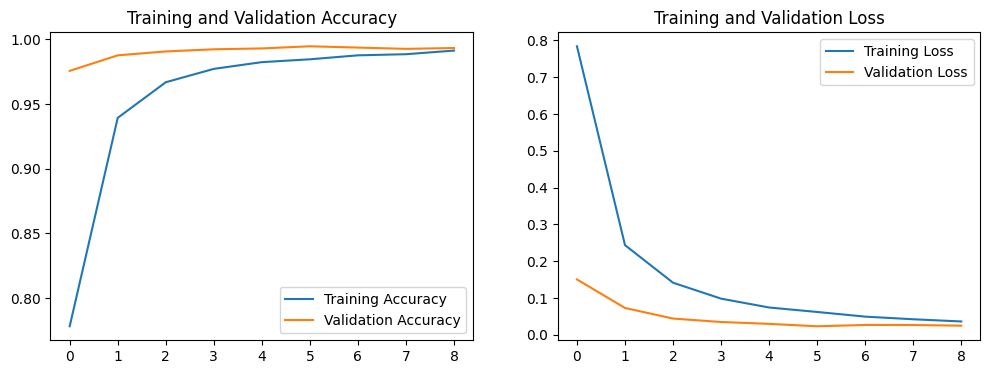

In [ ]:
# Ploting the accuracy score graph

# Extract history data
acc = history_VGG.history['accuracy']
val_acc = history_VGG.history['val_accuracy']
loss = history_VGG.history['loss']
val_loss = history_VGG.history['val_loss']
epochs_range = range(len(acc))

# Plot Accuracy
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

# Plot Loss
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')

plt.show()

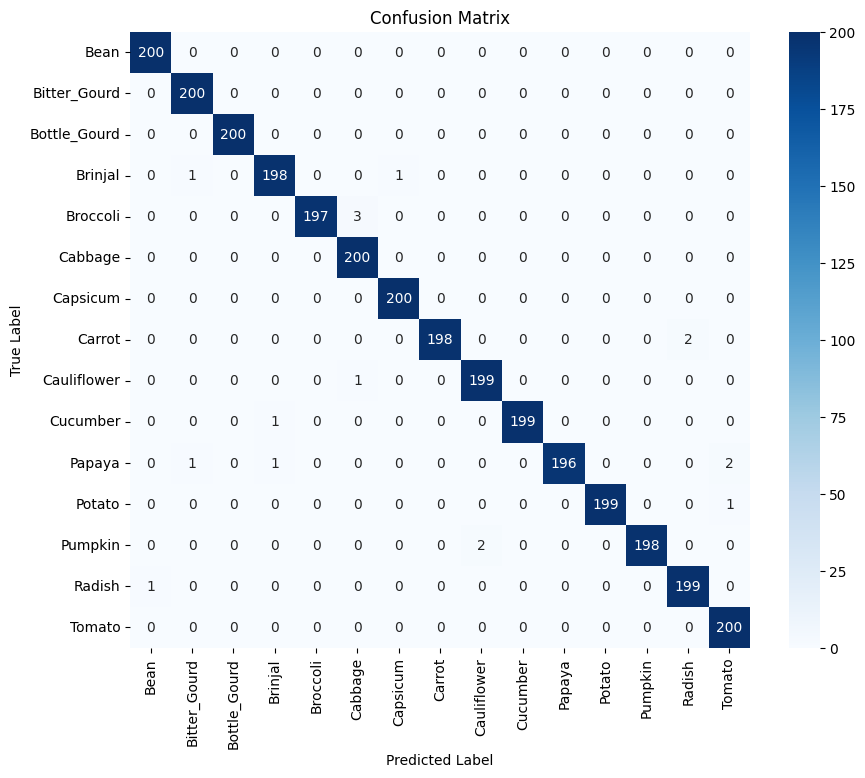

Classification Report:
               precision    recall  f1-score   support

        Bean       1.00      1.00      1.00       200
Bitter_Gourd       0.99      1.00      1.00       200
Bottle_Gourd       1.00      1.00      1.00       200
     Brinjal       0.99      0.99      0.99       200
    Broccoli       1.00      0.98      0.99       200
     Cabbage       0.98      1.00      0.99       200
    Capsicum       1.00      1.00      1.00       200
      Carrot       1.00      0.99      0.99       200
 Cauliflower       0.99      0.99      0.99       200
    Cucumber       1.00      0.99      1.00       200
      Papaya       1.00      0.98      0.99       200
      Potato       1.00      0.99      1.00       200
     Pumpkin       1.00      0.99      0.99       200
      Radish       0.99      0.99      0.99       200
      Tomato       0.99      1.00      0.99       200

    accuracy                           0.99      3000
   macro avg       0.99      0.99      0.99      3000
we

In [ ]:
# Ploting confusion matrix

# Ensure all images are processed
steps = test_data.samples // test_data.batch_size

# Get predictions
y_pred_probs = model_VGG.predict(test_data, steps=steps, verbose=0)  # Silent prediction
y_pred = np.argmax(y_pred_probs, axis=1)  # Convert probabilities to class indices


y_true = test_data.classes

cm = confusion_matrix(y_true, y_pred)

class_labels = list(test_data.class_indices.keys())

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

print("Classification Report:\n", classification_report(y_true, y_pred, target_names=class_labels))

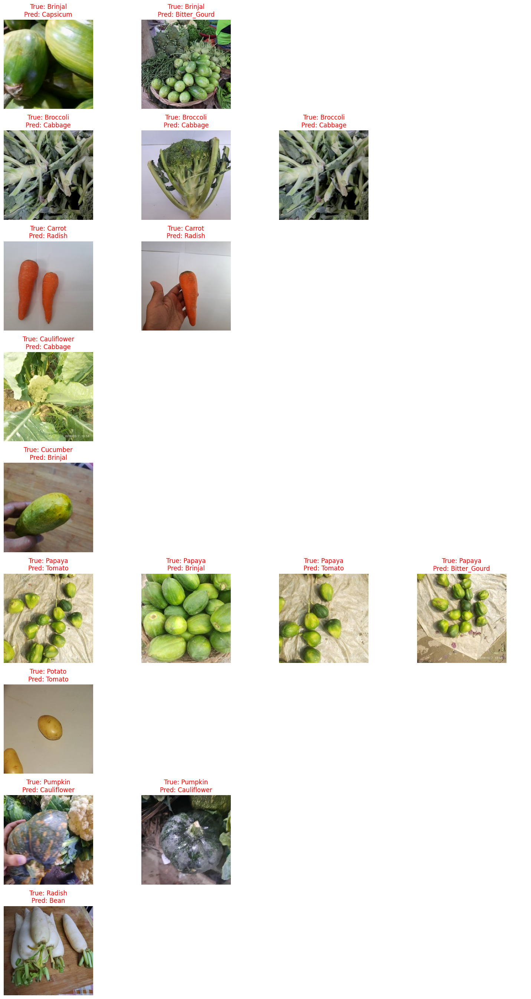

In [ ]:

test_data.reset()

y_pred_probs = model_VGG.predict(test_data, steps=test_data.samples // test_data.batch_size, verbose=0)
y_pred = np.argmax(y_pred_probs, axis=1)
y_true = test_data.classes

class_labels = list(test_data.class_indices.keys())

misclassified_images = {cls: [] for cls in class_labels}

for i in range(len(y_true)):
    true_class = y_true[i]
    pred_class = y_pred[i]

    if true_class != pred_class:
        class_name = class_labels[true_class]
        if len(misclassified_images[class_name]) < 5:
            misclassified_images[class_name].append((test_data.filepaths[i], class_labels[true_class], class_labels[pred_class]))

misclassified_images = {cls: imgs for cls, imgs in misclassified_images.items() if len(imgs) > 0}

num_classes_with_errors = len(misclassified_images)
if num_classes_with_errors == 0:
    print("No misclassified images found.")
else:
    fig, axes = plt.subplots(num_classes_with_errors, max(len(imgs) for imgs in misclassified_images.values()),
                             figsize=(15, 3 * num_classes_with_errors))

    if num_classes_with_errors == 1:
        axes = [axes]

    for i, (cls, images_list) in enumerate(misclassified_images.items()):
        for j, (img_path, true_label, pred_label) in enumerate(images_list):
            img = plt.imread(img_path)
            axes[i][j].imshow(img)
            axes[i][j].set_title(f"True: {true_label}\nPred: {pred_label}", color='red')
            axes[i][j].axis("off")

        for j in range(len(images_list), axes.shape[1]):
            axes[i][j].axis("off")

    plt.tight_layout()
    plt.show()

## <font color=#FF69B4>**3.3 - GoogLeNet CNN Architecture - Transfer Learning**</font>

<font color=#FF69B4>
GoogLeNet’s key advantages are its:

<font color=#FF69B4>

*   Efficiency (Fewer parameters despite increased depth)
*   Multi-Scale Feature Learning (Inception modules extract diverse spatial features)

</font>
By utilizing parallel convolutional pathways, GoogLeNet achieves higher computational efficiency and reduces overfitting, making it ideal for large-scale image classification. This makes it well-suited for vegetable classification, where handling variations in scale, orientation, and background noise is as important as feature depth.

</font>

## Base Line GoogLeNet

In [13]:
# Load Pre-trained InceptionV3 Model (without top layers)
baseLine_model_GoogLeNet = InceptionV3(weights=None, include_top=False, input_shape=(224, 224, 3))

# Freeze convolutional base (prevent modifying pre-trained weights)
for layer in baseLine_model_GoogLeNet.layers:
    layer.trainable = False

# Create a custom classification head
baseLine_GoogLeNet = Sequential([
    baseLine_model_GoogLeNet,
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(15, activation='softmax')
])

baseLine_GoogLeNet.compile(optimizer=Adam(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Define callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

# Train the model
baseLine_history_GoogLeNet = baseLine_GoogLeNet.fit(
    train_data,
    validation_data=val_data,
    epochs=10,
    batch_size=32,
    callbacks=[early_stopping, reduce_lr]
)

Epoch 1/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 59s 47ms/step - accuracy: 0.0660 - loss: 2.7064 - val_accuracy: 0.0890 - val_loss: 2.7012 - learning_rate: 1.0000e-04
Epoch 2/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 22s 24ms/step - accuracy: 0.0745 - loss: 2.7008 - val_accuracy: 0.0667 - val_loss: 2.6943 - learning_rate: 1.0000e-04
Epoch 3/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 23s 25ms/step - accuracy: 0.0798 - loss: 2.6929 - val_accuracy: 0.1023 - val_loss: 2.6845 - learning_rate: 1.0000e-04
Epoch 4/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 24s 25ms/step - accuracy: 0.0995 - loss: 2.6836 - val_accuracy: 0.1510 - val_loss: 2.6715 - learning_rate: 1.0000e-04
Epoch 5/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 23s 24ms/step - accuracy: 0.1278 - loss: 2.6697 - val_accuracy: 0.1667 - val_loss: 2.6544 - learning_rate: 1.0000e-04
Epoch 6/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 23s 25ms/step - accuracy: 0.1440 - loss: 2.6536 - val_accuracy: 0.1943 - val_loss: 2.6343 - learning_rate: 1.0000e-04
Epoch 7/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 23s 25ms/ste

In [14]:
baseLine_GoogLeNet.save("veg_clf_GoogLeNet_BaseLine.h5")

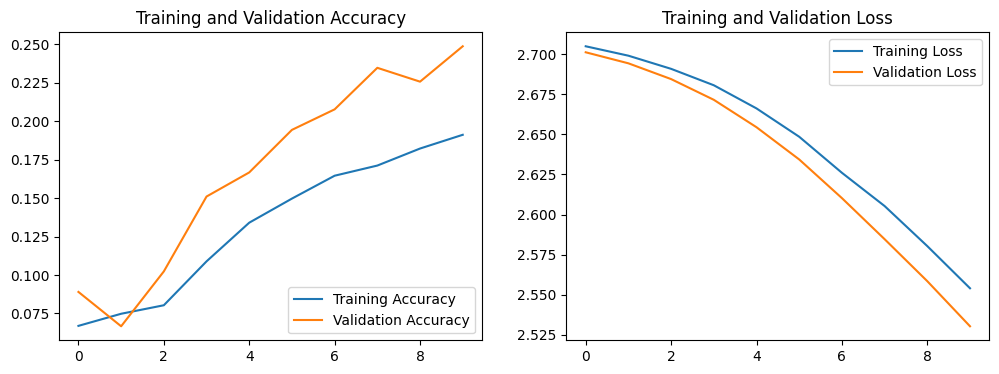

In [15]:
# Ploting the accuracy score graph

# Extract history data
acc = baseLine_history_GoogLeNet.history['accuracy']
val_acc = baseLine_history_GoogLeNet.history['val_accuracy']
loss = baseLine_history_GoogLeNet.history['loss']
val_loss = baseLine_history_GoogLeNet.history['val_loss']
epochs_range = range(len(acc))

# Plot Accuracy
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

# Plot Loss
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')

plt.show()

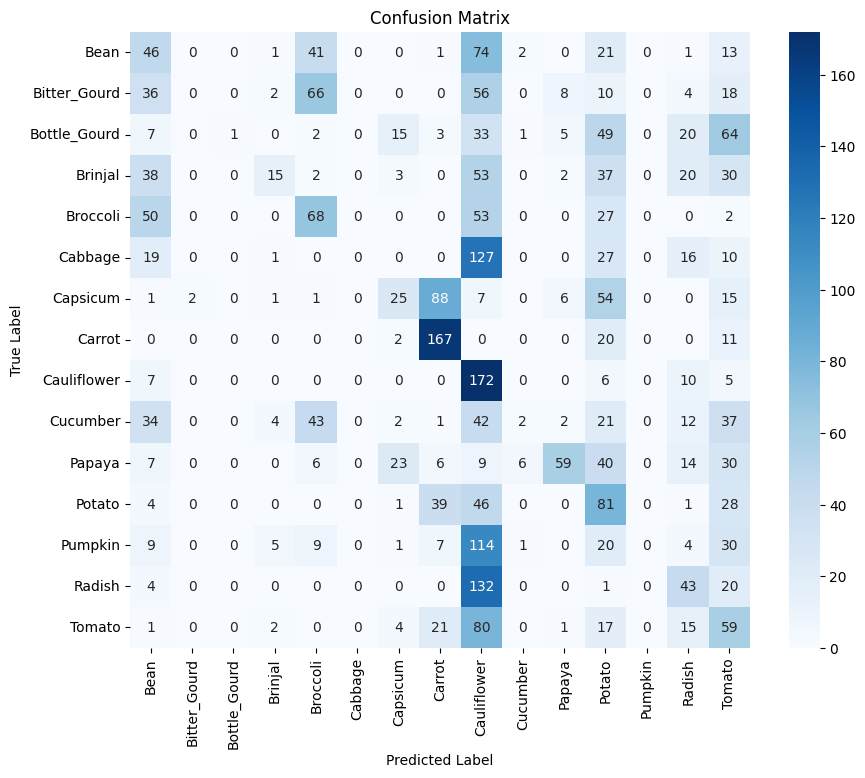

Classification Report:
               precision    recall  f1-score   support

        Bean       0.17      0.23      0.20       200
Bitter_Gourd       0.00      0.00      0.00       200
Bottle_Gourd       1.00      0.01      0.01       200
     Brinjal       0.48      0.07      0.13       200
    Broccoli       0.29      0.34      0.31       200
     Cabbage       0.00      0.00      0.00       200
    Capsicum       0.33      0.12      0.18       200
      Carrot       0.50      0.83      0.63       200
 Cauliflower       0.17      0.86      0.29       200
    Cucumber       0.17      0.01      0.02       200
      Papaya       0.71      0.29      0.42       200
      Potato       0.19      0.41      0.26       200
     Pumpkin       0.00      0.00      0.00       200
      Radish       0.27      0.21      0.24       200
      Tomato       0.16      0.29      0.21       200

    accuracy                           0.25      3000
   macro avg       0.30      0.25      0.19      3000
we

In [16]:
# Ploting confusion matrix

steps = test_data.samples // test_data.batch_size

y_pred_probs = baseLine_GoogLeNet.predict(test_data, steps=steps, verbose=0)
y_pred = np.argmax(y_pred_probs, axis=1)

y_true = test_data.classes

cm = confusion_matrix(y_true, y_pred)

class_labels = list(test_data.class_indices.keys())

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_true, y_pred, target_names=class_labels))

-------------------------------------------------------------------------------------------------

## GoogLeNet Model With IMAGENET weights

In [ ]:
# Load Pre-trained InceptionV3 Model (without top layers)
base_model_GoogLeNet = InceptionV3(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze convolutional base (prevent modifying pre-trained weights)
for layer in base_model_GoogLeNet.layers:
    layer.trainable = False

# Create a custom classification head
model_GoogLeNet = Sequential([
    base_model_GoogLeNet,
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(15, activation='softmax')
])

model_GoogLeNet.compile(optimizer=Adam(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])


87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


<font color=#FF69B4>Model Training</font>

In [ ]:
# Define callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)

# Train the model
history_GoogLeNet = model_GoogLeNet.fit(
    train_data,
    validation_data=val_data,
    epochs=10,
    batch_size=32,
    callbacks=[early_stopping, reduce_lr]
)

Epoch 1/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 62s 50ms/step - accuracy: 0.8181 - loss: 0.6810 - val_accuracy: 0.9880 - val_loss: 0.0455 - learning_rate: 1.0000e-04
Epoch 2/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 25s 27ms/step - accuracy: 0.9633 - loss: 0.1133 - val_accuracy: 0.9927 - val_loss: 0.0292 - learning_rate: 1.0000e-04
Epoch 3/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 25s 27ms/step - accuracy: 0.9799 - loss: 0.0665 - val_accuracy: 0.9917 - val_loss: 0.0287 - learning_rate: 1.0000e-04
Epoch 4/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 25s 26ms/step - accuracy: 0.9758 - loss: 0.0750 - val_accuracy: 0.9913 - val_loss: 0.0524 - learning_rate: 1.0000e-04
Epoch 5/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 25s 27ms/step - accuracy: 0.9821 - loss: 0.0584 - val_accuracy: 0.9933 - val_loss: 0.0219 - learning_rate: 1.0000e-04
Epoch 6/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 24s 26ms/step - accuracy: 0.9871 - loss: 0.0437 - val_accuracy: 0.9940 - val_loss: 0.0316 - learning_rate: 1.0000e-04
Epoch 7/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 25s 26ms/ste

In [ ]:
model_GoogLeNet.save("veg_clf_GoogLeNet_.h5")

<font color=#FF69B4>Model Evaluation</font>

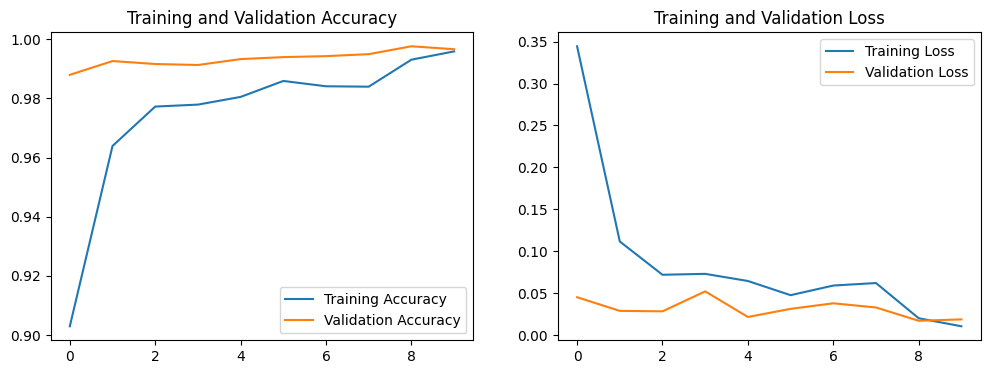

In [ ]:
# Ploting the accuracy score graph

# Extract history data
acc = history_GoogLeNet.history['accuracy']
val_acc = history_GoogLeNet.history['val_accuracy']
loss = history_GoogLeNet.history['loss']
val_loss = history_GoogLeNet.history['val_loss']
epochs_range = range(len(acc))

# Plot Accuracy
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

# Plot Loss
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')

plt.show()

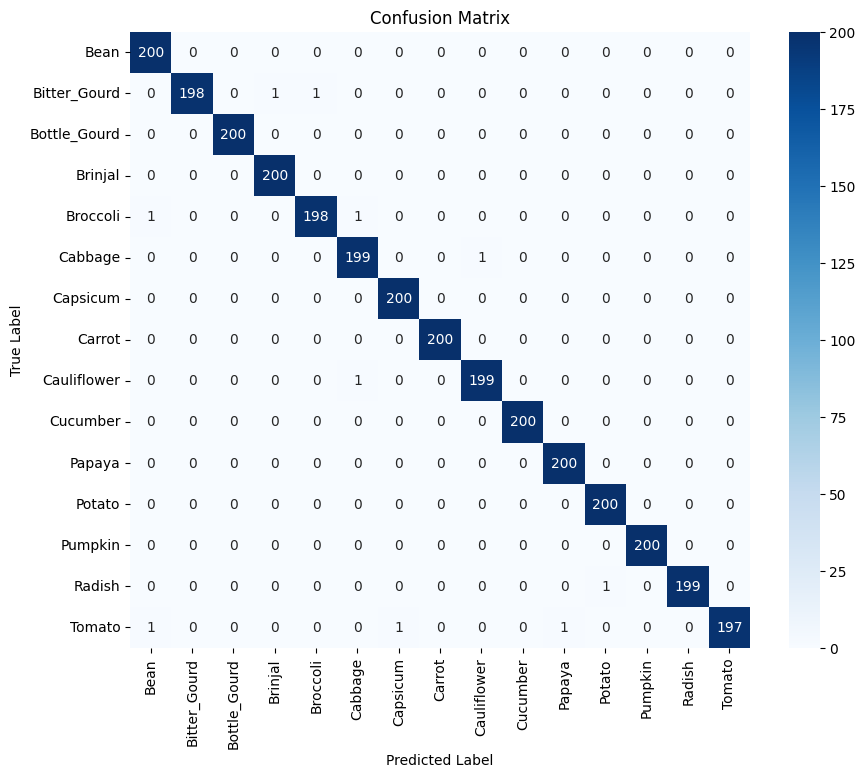

Classification Report:
               precision    recall  f1-score   support

        Bean       0.99      1.00      1.00       200
Bitter_Gourd       1.00      0.99      0.99       200
Bottle_Gourd       1.00      1.00      1.00       200
     Brinjal       1.00      1.00      1.00       200
    Broccoli       0.99      0.99      0.99       200
     Cabbage       0.99      0.99      0.99       200
    Capsicum       1.00      1.00      1.00       200
      Carrot       1.00      1.00      1.00       200
 Cauliflower       0.99      0.99      0.99       200
    Cucumber       1.00      1.00      1.00       200
      Papaya       1.00      1.00      1.00       200
      Potato       1.00      1.00      1.00       200
     Pumpkin       1.00      1.00      1.00       200
      Radish       1.00      0.99      1.00       200
      Tomato       1.00      0.98      0.99       200

    accuracy                           1.00      3000
   macro avg       1.00      1.00      1.00      3000
we

In [ ]:
# Ploting confusion matrix

steps = test_data.samples // test_data.batch_size

y_pred_probs = model_GoogLeNet.predict(test_data, steps=steps, verbose=0)
y_pred = np.argmax(y_pred_probs, axis=1)

y_true = test_data.classes

cm = confusion_matrix(y_true, y_pred)

class_labels = list(test_data.class_indices.keys())

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_true, y_pred, target_names=class_labels))

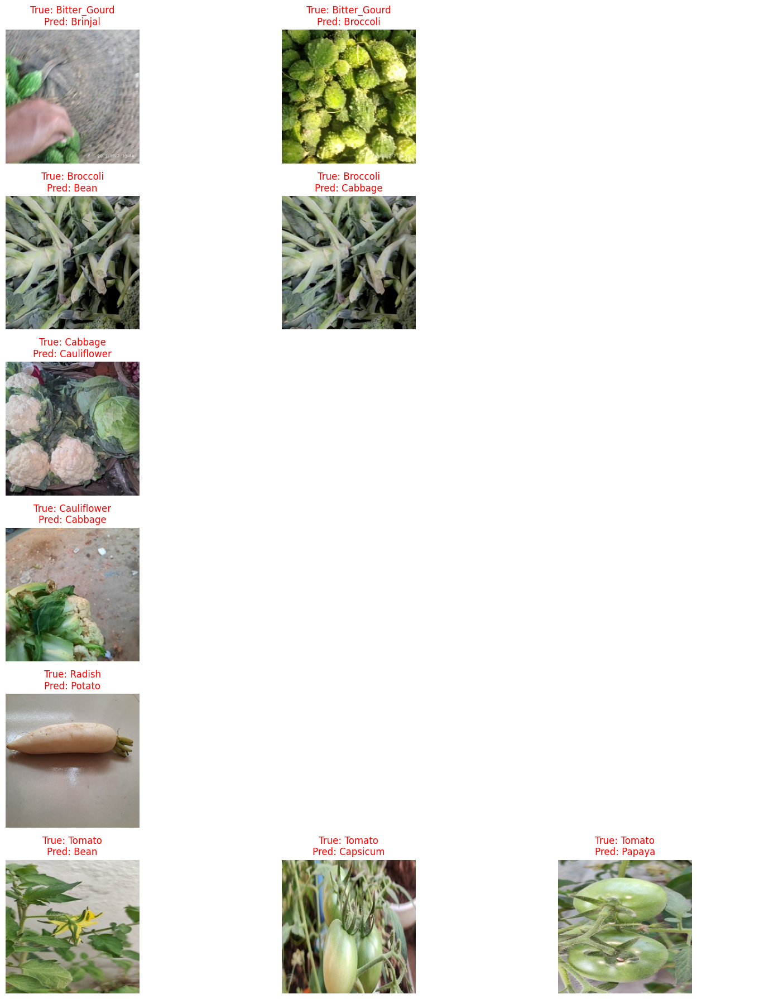

In [ ]:

test_data.reset()

y_pred_probs = model_GoogLeNet.predict(test_data, steps=test_data.samples // test_data.batch_size, verbose=0)
y_pred = np.argmax(y_pred_probs, axis=1)
y_true = test_data.classes

class_labels = list(test_data.class_indices.keys())

misclassified_images = {cls: [] for cls in class_labels}

for i in range(len(y_true)):
    true_class = y_true[i]
    pred_class = y_pred[i]

    if true_class != pred_class:
        class_name = class_labels[true_class]
        if len(misclassified_images[class_name]) < 5:
            misclassified_images[class_name].append((test_data.filepaths[i], class_labels[true_class], class_labels[pred_class]))

misclassified_images = {cls: imgs for cls, imgs in misclassified_images.items() if len(imgs) > 0}

num_classes_with_errors = len(misclassified_images)
if num_classes_with_errors == 0:
    print("No misclassified images found.")
else:
    fig, axes = plt.subplots(num_classes_with_errors, max(len(imgs) for imgs in misclassified_images.values()),
                             figsize=(15, 3 * num_classes_with_errors))

    if num_classes_with_errors == 1:
        axes = [axes]

    for i, (cls, images_list) in enumerate(misclassified_images.items()):
        for j, (img_path, true_label, pred_label) in enumerate(images_list):
            img = plt.imread(img_path)
            axes[i][j].imshow(img)
            axes[i][j].set_title(f"True: {true_label}\nPred: {pred_label}", color='red')
            axes[i][j].axis("off")

        for j in range(len(images_list), axes.shape[1]):
            axes[i][j].axis("off")

    plt.tight_layout()
    plt.show()